In [ ]:
# =============================
# Cell 1: Install Dependencies
# =============================

!pip install ultralytics opencv-python seaborn matplotlib scipy

# Optional: If OpenCV errors occur, try this:
# !apt-get install -y libglib2.0-0 libsm6 libxrender-dev libxext6

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 23.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 26.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 19.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 73.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling n

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving yolov8m.pt to yolov8m.pt


In [ ]:
# =============================
# Cell 2: Import Libraries
# =============================

import cv2
import numpy as np
import time
from ultralytics import YOLO
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
# =============================
# Cell 4: Load Model and Video
# =============================

yolo_model = YOLO("yolov8n.pt")  # Use 'yolov8m.pt' if needed

cap = cv2.VideoCapture("drone_video1.mp4")

ret, prev_frame = cap.read()
if not ret:
    print("Error reading video.")
    cap.release()
    raise SystemExit

prev_gray = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)

# Define VideoWriter to save output
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter('output_video.mp4', fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))))

motion_threshold = 3
stationary_frames_threshold = 30
object_tracker = {}
frame_count = 0
survivor_points = []

100%|██████████| 6.25M/6.25M [00:00<00:00, 60.4MB/s]


In [ ]:
# =============================
# Cell 5: Process Video Frames
# =============================

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    flow = cv2.calcOpticalFlowFarneback(prev_gray, gray, None,
                                        0.5, 3, 15, 3, 5, 1.2, 0)
    mag, ang = cv2.cartToPolar(flow[..., 0], flow[..., 1])
    motion_mask = mag > motion_threshold

    if np.any(motion_mask):
        results = yolo_model(frame, stream=True)
        for result in results:
            for box in result.boxes:
                cls = int(box.cls[0])
                if cls == 0:
                    x1, y1, x2, y2 = map(int, box.xyxy[0])
                    object_id = (x1, y1, x2, y2)
                    if object_id in object_tracker:
                        if frame_count - object_tracker[object_id] > stationary_frames_threshold:
                            continue
                    object_tracker[object_id] = frame_count
                    center_x = int((x1 + x2) / 2)
                    center_y = int((y1 + y2) / 2)
                    survivor_points.append((center_x, center_y))
                    cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
                    cv2.putText(frame, "Survivor", (x1, y1 - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    out.write(frame)  # Save frame

    prev_gray = gray.copy()

cap.release()
out.release()


0: 384x640 3 persons, 6 cars, 3 cell phones, 378.4ms
Speed: 6.1ms preprocess, 378.4ms inference, 42.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 5 persons, 5 cars, 2 cell phones, 142.6ms
Speed: 3.6ms preprocess, 142.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 6 persons, 5 cars, 2 cell phones, 143.1ms
Speed: 3.9ms preprocess, 143.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 persons, 7 cars, 1 bus, 1 truck, 2 cell phones, 140.7ms
Speed: 4.2ms preprocess, 140.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 5 cars, 2 trucks, 4 cell phones, 163.4ms
Speed: 3.7ms preprocess, 163.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 7 cars, 4 cell phones, 158.7ms
Speed: 3.6ms preprocess, 158.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 8 cars, 1 truck, 4 cell phones, 148.1ms


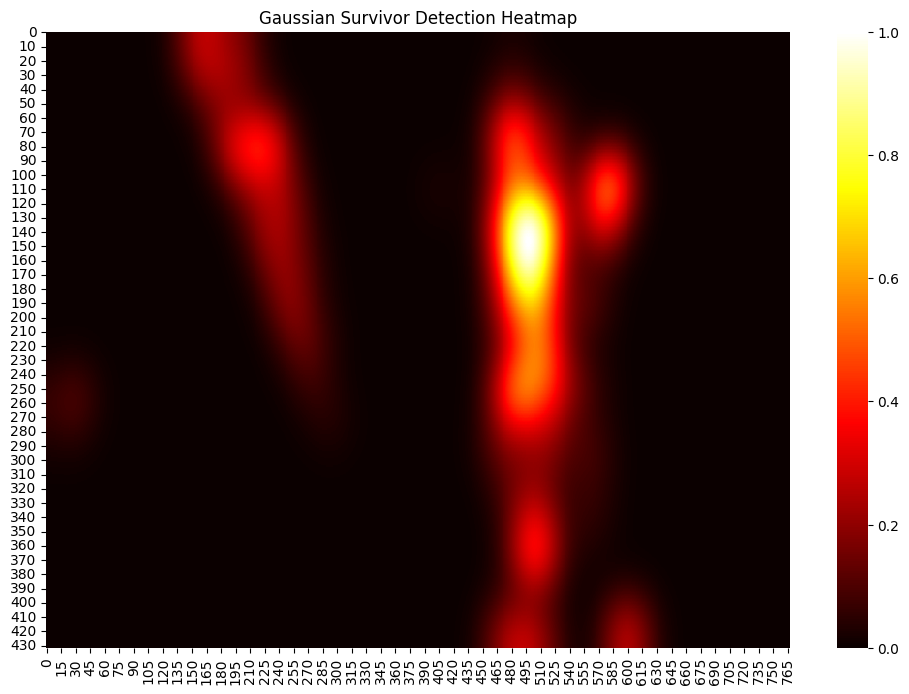

In [ ]:
# =============================
# Cell 6: Generate Heatmap
# =============================

heatmap_data = np.zeros((prev_frame.shape[0], prev_frame.shape[1]))

for x, y in survivor_points:
    if 0 <= y < heatmap_data.shape[0] and 0 <= x < heatmap_data.shape[1]:
        heatmap_data[y, x] += 1

blurred_heatmap = gaussian_filter(heatmap_data, sigma=20)
normalized_heatmap = blurred_heatmap / np.max(blurred_heatmap)

plt.figure(figsize=(12, 8))
sns.heatmap(normalized_heatmap, cmap='hot', cbar=True)
plt.title("Gaussian Survivor Detection Heatmap")
plt.savefig("gaussian_heatmap.png")
plt.show()

In [ ]:
from IPython.display import HTML
from base64 import b64encode

video_path = "output_video.mp4"

with open(video_path, "rb") as video_file:
    video_data = video_file.read()
    video_encoded = b64encode(video_data).decode()

video_html = f"""
<video width=600 controls>
    <source src="data:video/mp4;base64,{video_encoded}" type="video/mp4">
</video>
"""
HTML(video_html)

In [ ]:
import os

output_video_path = "output_video.mp4"

if os.path.exists(output_video_path):
    size = os.path.getsize(output_video_path)
    print(f"Video file exists. Size: {size} bytes")
else:
    print("Video file does not exist.")

Video file exists. Size: 12168625 bytes


In [ ]:
from IPython.display import HTML
from base64 import b64encode

mp4_path = "output_video.mp4"
mp4 = open(mp4_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width=600 controls>
    <source src="{data_url}" type="video/mp4">
</video>
""")

In [ ]:
from google.colab import files
files.download("output_video.mp4")

FileNotFoundError: Cannot find file: output_video.mp4

In [ ]:
import cv2
import numpy as np
from ultralytics import YOLO

# Load YOLO model
model = YOLO("yolov8n.pt")

# Load video
cap = cv2.VideoCapture("drone_video1.mp4")
ret, frame = cap.read()
height, width = frame.shape[:2]

# Heatmap canvas
heatmap = np.zeros((height, width), dtype=np.float32)

# Gaussian blob function
def draw_gaussian_blob(canvas, center, radius=40, intensity=1.0):
    x, y = center
    size = radius * 2 + 1
    gaussian = cv2.getGaussianKernel(size, radius)
    blob = gaussian @ gaussian.T
    blob = blob / blob.max() * intensity

    x1 = max(0, x - radius)
    y1 = max(0, y - radius)
    x2 = min(width, x + radius + 1)
    y2 = min(height, y + radius + 1)

    blob_x1 = max(0, radius - x)
    blob_y1 = max(0, radius - y)
    blob_x2 = blob_x1 + (x2 - x1)
    blob_y2 = blob_y1 + (y2 - y1)

    canvas[y1:y2, x1:x2] += blob[blob_y1:blob_y2, blob_x1:blob_x2]

In [ ]:
# Setup video writer for output
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out_path = 'turbo_heatmap_output.mp4'
out = cv2.VideoWriter(out_path, fourcc, 20.0, (width, height))

# Reset to beginning of video
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)
ret, frame = cap.read()

while ret:
    detections = model(frame, stream=True)

    for result in detections:
        for box in result.boxes:
            cls_id = int(box.cls[0])
            if cls_id == 0:  # 'person' class
                x1, y1, x2, y2 = map(int, box.xyxy[0])
                cx, cy = (x1 + x2) // 2, (y1 + y2) // 2
                draw_gaussian_blob(heatmap, (cx, cy), radius=30, intensity=1.0)

    # Create turbo heatmap overlay
    norm_heatmap = cv2.normalize(heatmap, None, 0, 255, cv2.NORM_MINMAX)
    norm_heatmap = np.uint8(norm_heatmap)
    color_heatmap = cv2.applyColorMap(norm_heatmap, cv2.COLORMAP_TURBO)

    blended = cv2.addWeighted(frame, 0.6, color_heatmap, 0.4, 0)
    out.write(blended)

    ret, frame = cap.read()

cap.release()
out.release()
print("Turbo heatmap video saved as:", out_path)


0: 384x640 1 person, 4 cars, 3 cell phones, 154.3ms
Speed: 3.7ms preprocess, 154.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 cars, 2 cell phones, 144.7ms
Speed: 2.7ms preprocess, 144.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 3 cars, 3 cell phones, 157.9ms
Speed: 3.9ms preprocess, 157.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 3 cars, 3 cell phones, 145.4ms
Speed: 3.6ms preprocess, 145.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 cars, 3 cell phones, 144.7ms
Speed: 3.5ms preprocess, 144.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 cars, 3 cell phones, 515.5ms
Speed: 3.9ms preprocess, 515.5ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 persons, 4 cars, 3 cell phones, 386.2ms
Speed: 9.3ms preprocess, 386.2ms inference, 1.8ms postprocess per imag

In [ ]:
from IPython.display import Video

Video("turbo_heatmap_output.mp4", embed=True)

In [ ]:
from google.colab import files
files.download("turbo_heatmap_output.mp4")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>